Wholesale customers là dataset phục vụ cho bài toán customer segmentation dựa vào một số thông tin và hành vi của khách hàng
- Đọc dữ liệu
- Trực quan hóa dữ liệu
- Chuẩn hóa dữ liệu
- Dùng elbow method để chọn ra số clusters thích hợp (có thể chọn số clusters $\pm1$ để so sánh sự khác biệt)
- Biểu diễn các cụm sang không gian 2 chiều và 3 chiều
- Chọn ra một số data samples theo từng cụm để phân tích các giá trị trong đó

1. Analyze and Preprocess data - Check if the dataset has missing values or has any other problem.
2. Feature Engineering
3. Determine the cluster number
    3. a. Use elbow method as baseline
    3. b. Apply other methods to compare with elbow
4. Use Pipeline
    4. a. Use scaler and dimensional reduction (if it is necessary).
    4. b. Use suitable clustering model for this problem.
5. Visualize your cluster in 2D or 3D to compare the result.
6. Measure performance of your clustering model.
7. Conclusion and Discussion


How can I measure your point:
1. Your function is callable and runs correctly
2. The performance of your model (in full pipeline) is acceptable. The final error based on my train and test set is low enough.
3. The data preprocessing is correct or make sense
4. The Feature engineering is correct or make sense
5. Any other additional process will be considered a small plus point.

# Load Dataset

In [ ]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline

In [ ]:
df = pd.read_csv("{your_path}/data/Clustered_Customer_Data.csv")

In [ ]:
df.head()

,Unnamed: 0,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Cluster
0,0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,2
2,2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,3
3,3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12,0
4,4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0


# Data Analysis

* Data describe

In [ ]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,8950.0,4474.500000,2583.786788,0.000000,2237.250000,4474.500000,6711.750000,8949.00000
BALANCE,8950.0,1564.474828,2081.531879,0.000000,128.281915,873.385231,2054.140036,19043.13856
BALANCE_FREQUENCY,8950.0,0.877271,0.236904,0.000000,0.888889,1.000000,1.000000,1.00000
PURCHASES,8950.0,1003.204834,2136.634782,0.000000,39.635000,361.280000,1110.130000,49039.57000
ONEOFF_PURCHASES,8950.0,592.437371,1659.887917,0.000000,0.000000,38.000000,577.405000,40761.25000
INSTALLMENTS_PURCHASES,8950.0,411.067645,904.338115,0.000000,0.000000,89.000000,468.637500,22500.00000
CASH_ADVANCE,8950.0,978.871112,2097.163877,0.000000,0.000000,0.000000,1113.821139,47137.21176
PURCHASES_FREQUENCY,8950.0,0.490351,0.401371,0.000000,0.083333,0.500000,0.916667,1.00000
ONEOFF_PURCHASES_FREQUENCY,8950.0,0.202458,0.298336,0.000000,0.000000,0.083333,0.300000,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,8950.0,0.364437,0.397448,0.000000,0.000000,0.166667,0.750000,1.00000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 19 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Unnamed: 0                        8950 non-null   int64  
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

* Check null trong data

In [ ]:
df.isnull().sum()

Unnamed: 0                          0
BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
Cluster                             0
dtype: int64

* Count value '0' in dataset

In [ ]:
print('Count value 0:')
for col in df.columns:
  print(f'{col}: {len(df.loc[df[col]==0,col])}')

Count value 0:
Unnamed: 0: 1
BALANCE: 80
BALANCE_FREQUENCY: 80
PURCHASES: 2044
ONEOFF_PURCHASES: 4302
INSTALLMENTS_PURCHASES: 3916
CASH_ADVANCE: 4628
PURCHASES_FREQUENCY: 2043
ONEOFF_PURCHASES_FREQUENCY: 4302
PURCHASES_INSTALLMENTS_FREQUENCY: 3915
CASH_ADVANCE_FREQUENCY: 4628
CASH_ADVANCE_TRX: 4628
PURCHASES_TRX: 2044
CREDIT_LIMIT: 0
PAYMENTS: 240
MINIMUM_PAYMENTS: 0
PRC_FULL_PAYMENT: 5903
TENURE: 0
Cluster: 3976


* Dữ liệu trên chứa nhiều giá trị 0, tại đặc trưng PRC_FULL_PAYMENT chứa 5903 giá trị 0 nhiều nhất gần 66.25% dữ liệu

# Data Visualization

# Histogram plot

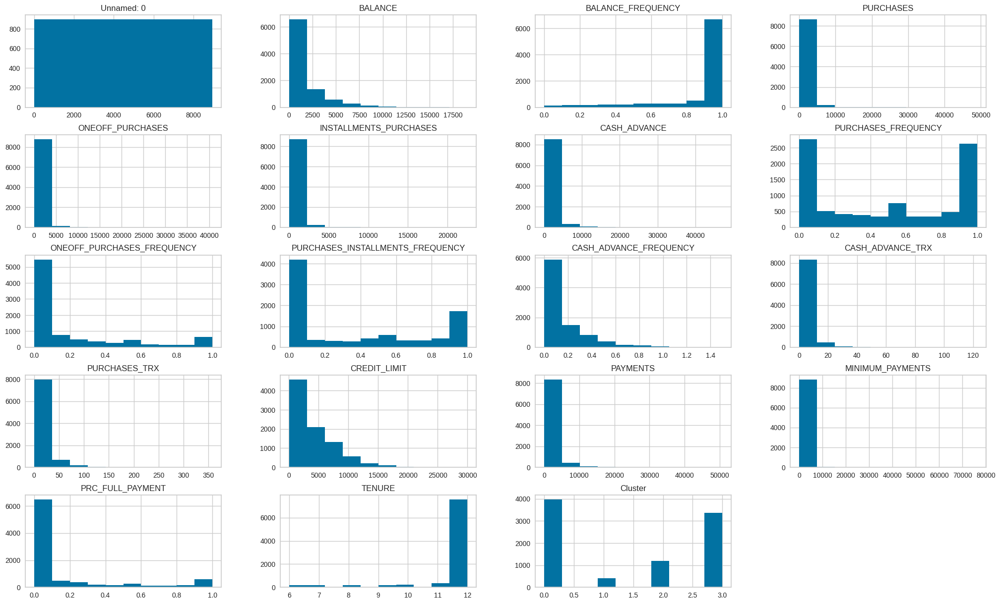

In [ ]:
df.hist(figsize=(25, 15))
plt.show()

* Đặc trưng Unamed 0 không có ý nghĩa giải thích
* Cluster là label để đánh giá thuật toán K-means

# Heatmap

<Axes: >

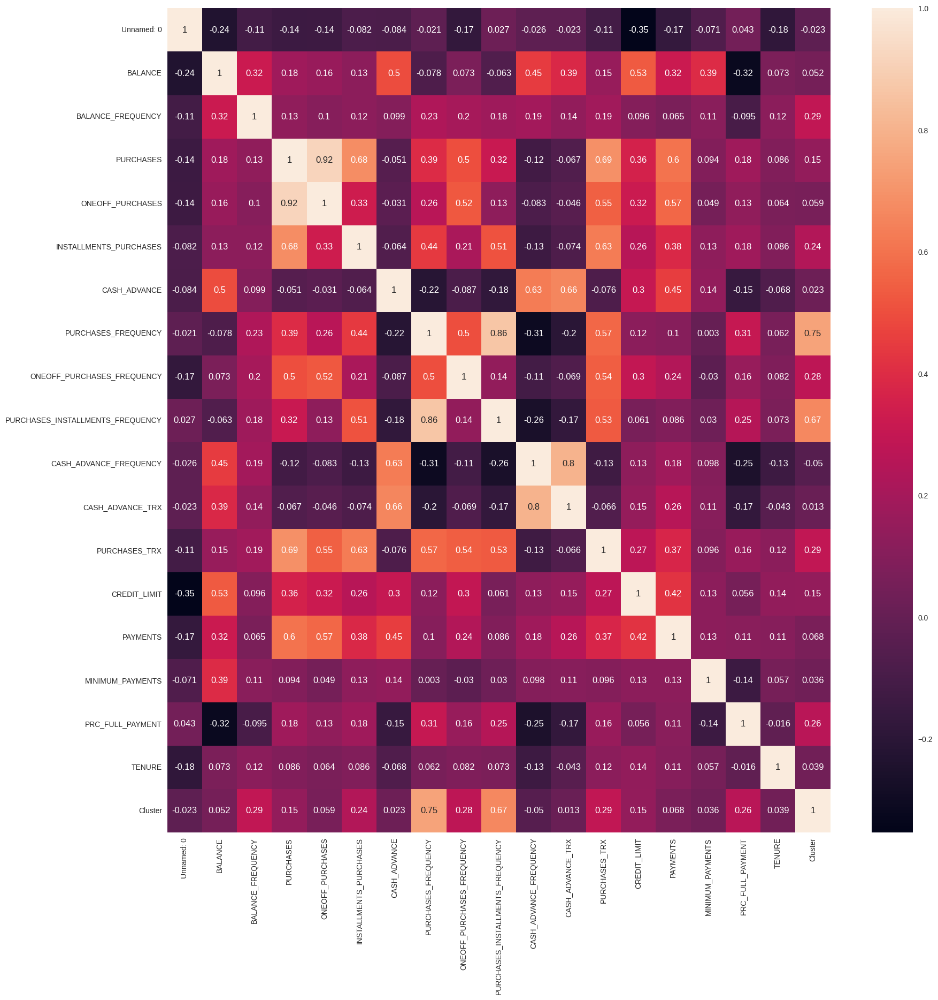

In [ ]:
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(), annot=True)

* Nhìn vào biểu đồ heatmap:
  * Purchases_installment_freq với Purchases_freq tương quan 0.86
  * CASH_ADVANCE_TRX với CASH_ADVANCE_FREQUENCY tương quan 0.8
  * ONEOFF_PURCHASES tương quan với PURCHASES 0.92

<ipython-input-240-ebedb7393702>:5: UserWarning:

The palette list has more values (7) than needed (4), which may not be intended.

<ipython-input-240-ebedb7393702>:5: UserWarning:

The palette list has more values (7) than needed (4), which may not be intended.

<ipython-input-240-ebedb7393702>:5: UserWarning:

The palette list has more values (7) than needed (4), which may not be intended.

<ipython-input-240-ebedb7393702>:5: UserWarning:

The palette list has more values (7) than needed (4), which may not be intended.

<ipython-input-240-ebedb7393702>:5: UserWarning:

The palette list has more values (7) than needed (4), which may not be intended.

<ipython-input-240-ebedb7393702>:5: UserWarning:

The palette list has more values (7) than needed (4), which may not be intended.

<ipython-input-240-ebedb7393702>:5: UserWarning:

The palette list has more values (7) than needed (4), which may not be intended.

<ipython-input-240-ebedb7393702>:5: UserWarning:

The palette list has more 

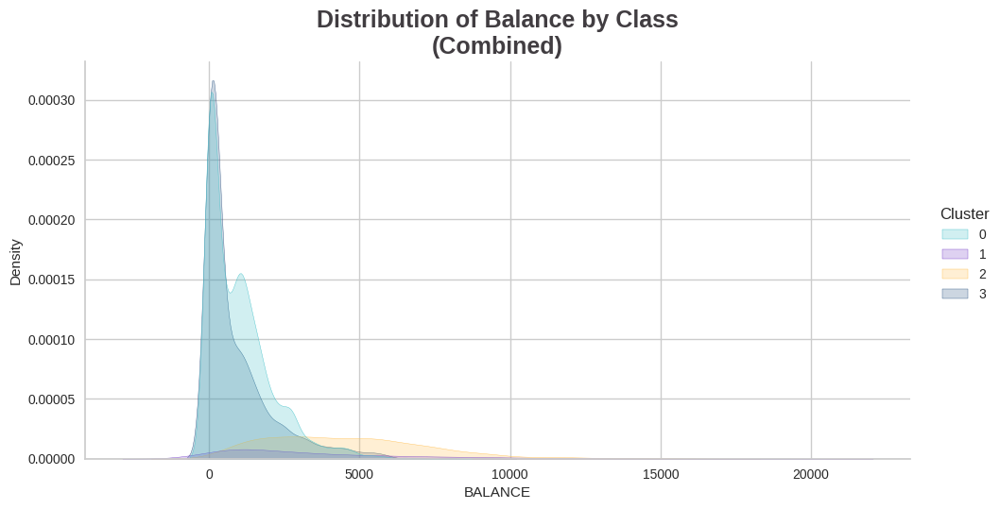

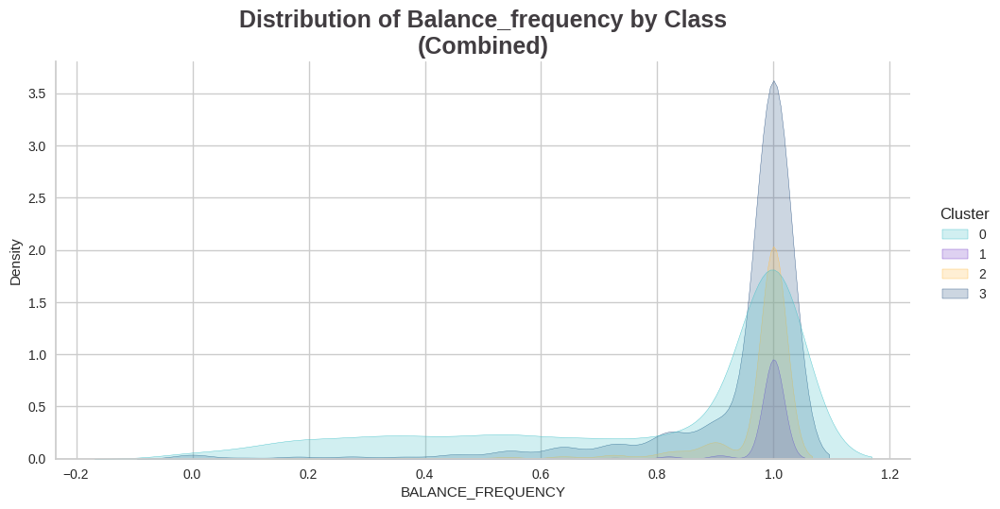

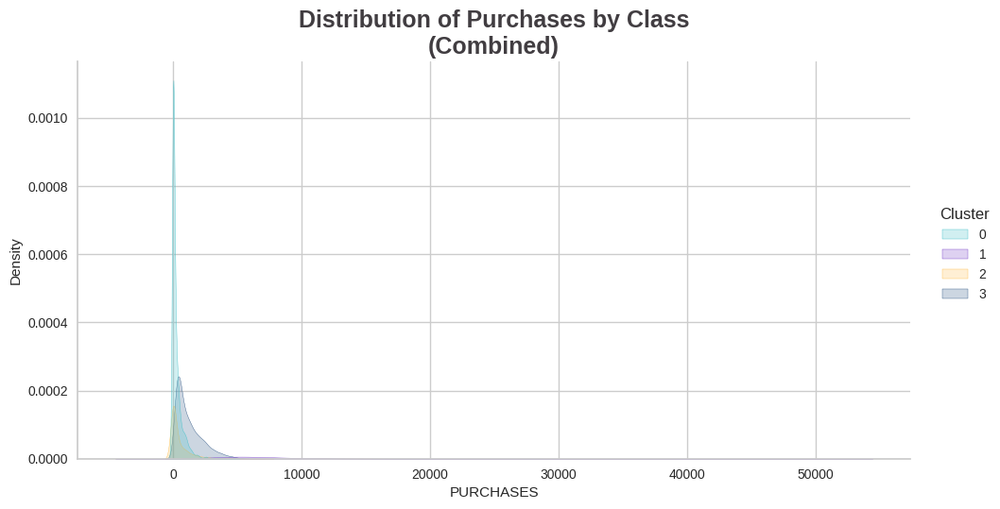

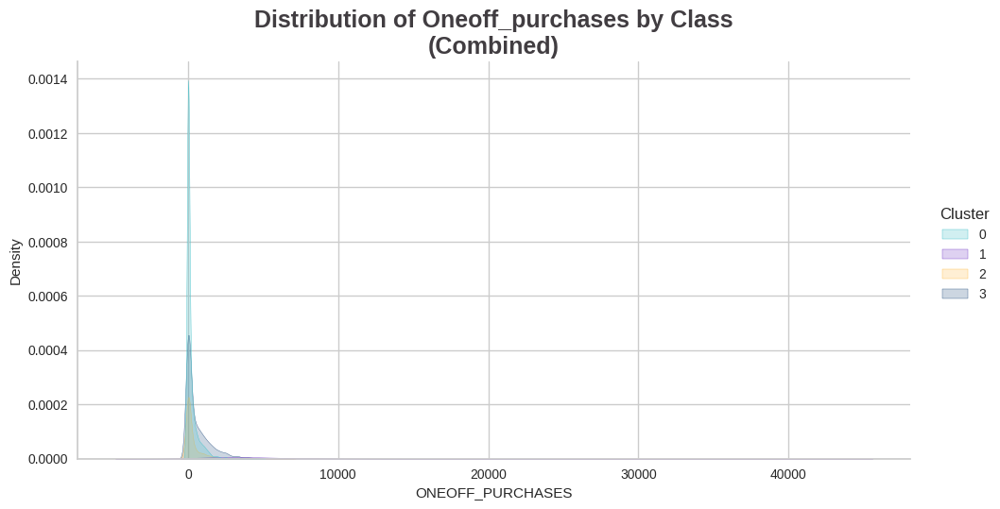

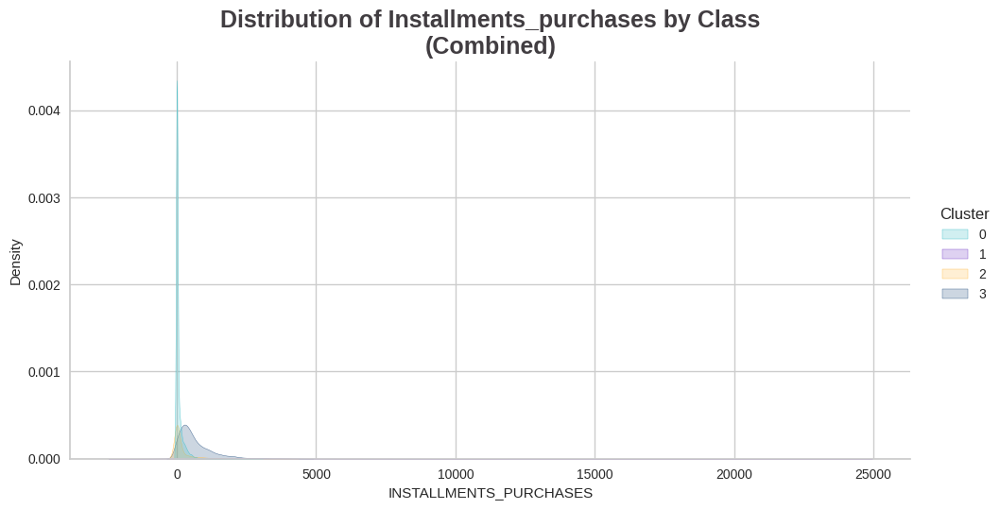

...

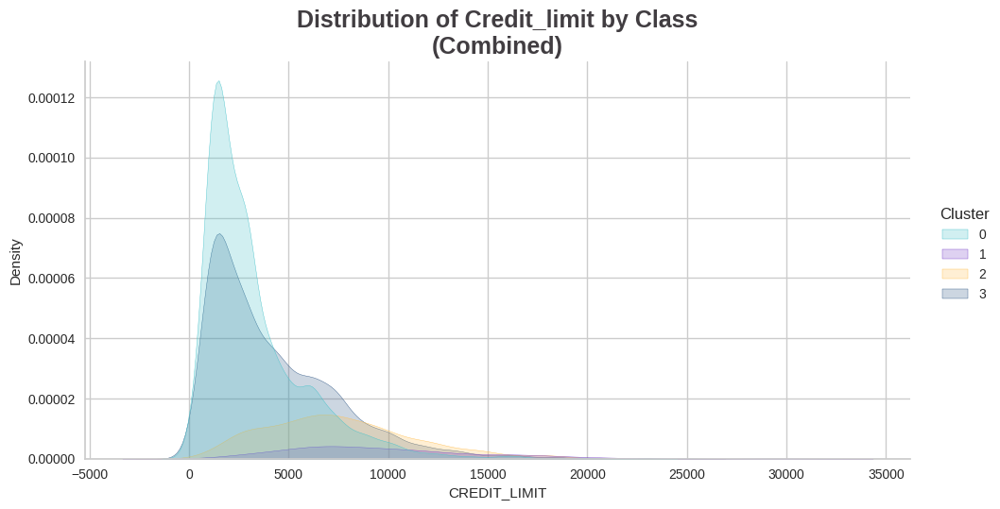

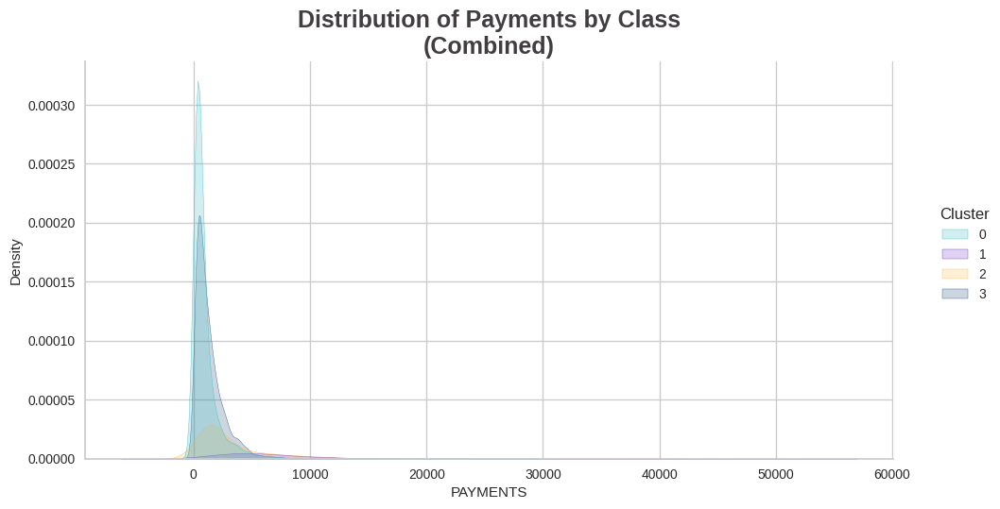

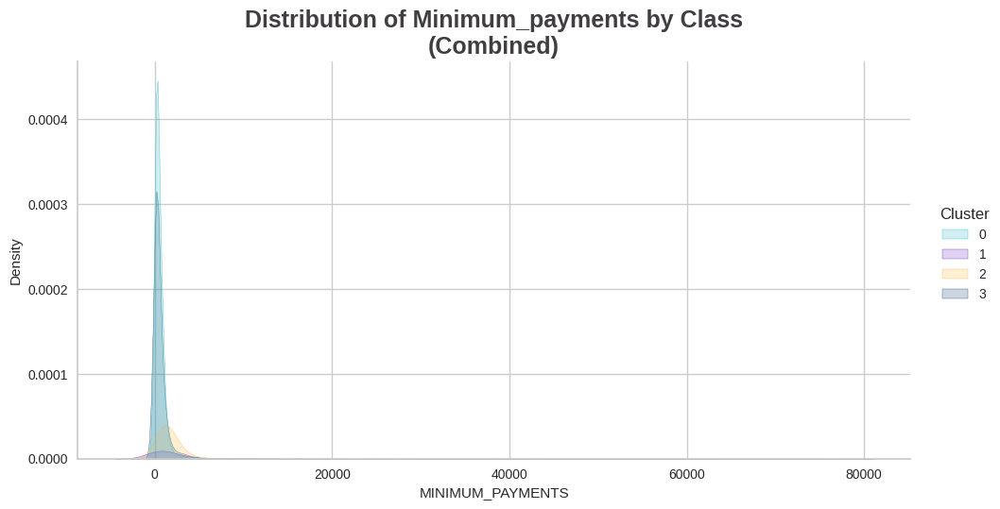

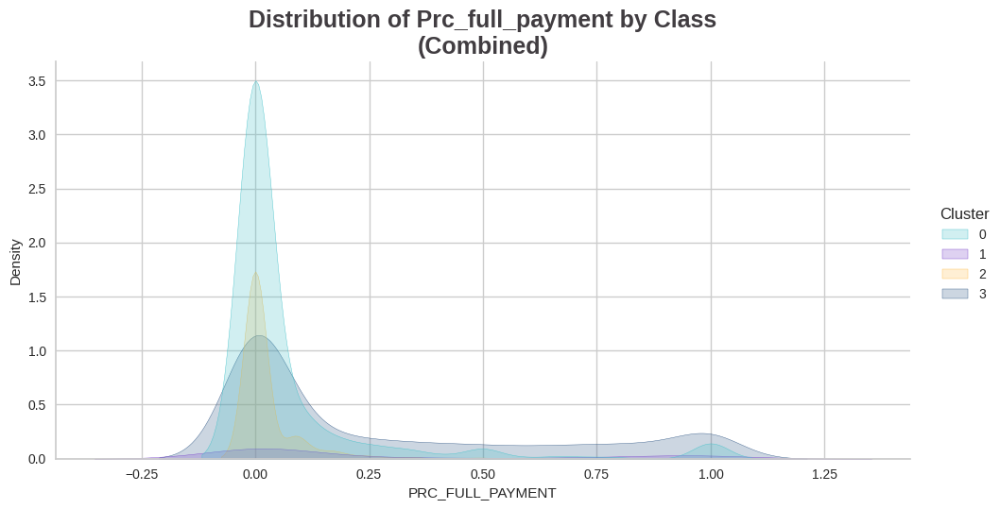

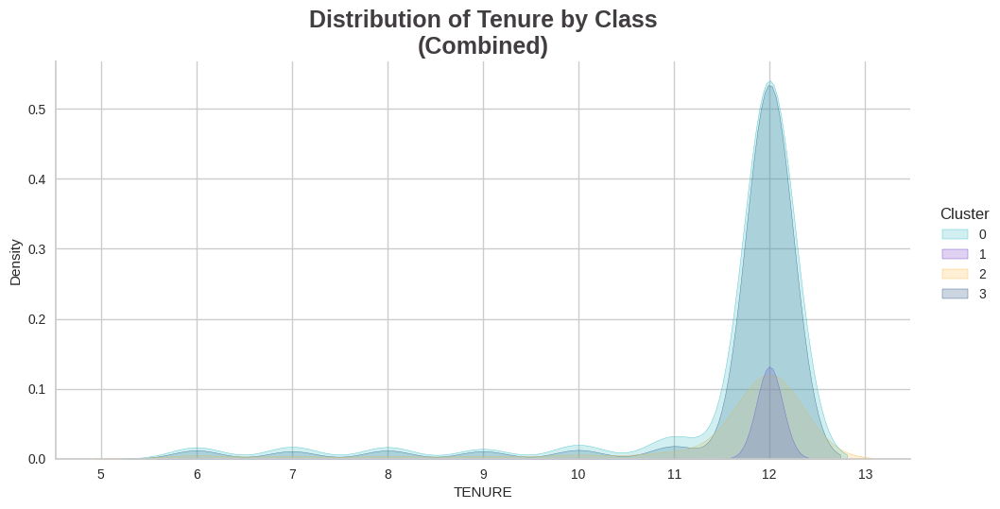

In [ ]:
colors = ['#49C3CB', '#7D49CB', '#FFC156', '#365C89',
          '#E9937E', '#9EE97E', '#F384BC']

for col in df.columns[1:-1]:
    sns.displot(data=df, x=col, hue='Cluster', kind='kde', # kernel density estimate
                    palette=colors, fill=True, legend=True, aspect=2)
    plt.title('Distribution of ' + col.capitalize() + ' by Class\n(Combined)',
                  size=18, fontweight='bold', color='#413D41')
plt.show();

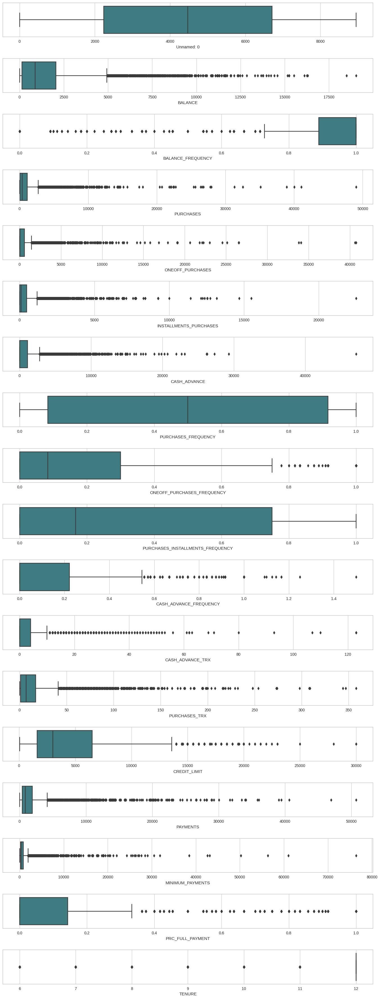

In [ ]:
box_cols = df.columns[:-1]
fig, axes=plt.subplots(len(box_cols), 1, figsize=(14, 2*len(box_cols)),sharex=False,sharey=False)

for i, column in enumerate(box_cols):
    sns.boxplot(x=column,data=df,palette='crest',ax=axes[i])
plt.tight_layout(pad=2.0)

Count plot

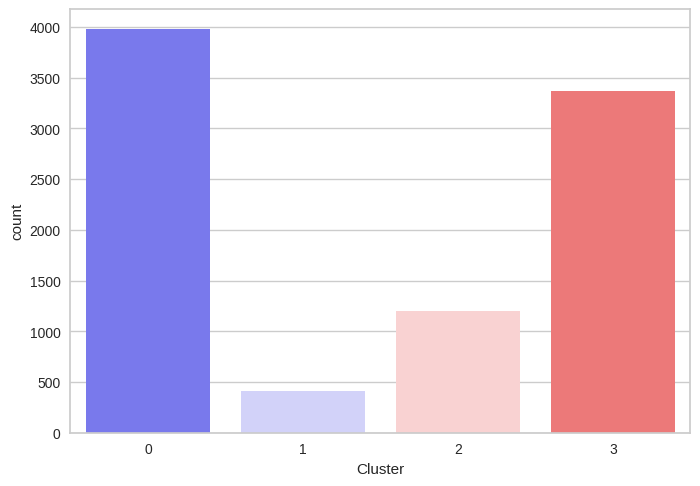

In [ ]:
sns.countplot(x = 'Cluster', data = df, palette = 'bwr')
plt.show()

In [ ]:
!pip install pandas-profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from pandas_profiling import ProfileReport

ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Data Preprocessing

In [ ]:
def preprocessing(data):
  cluster = data['Cluster']
  data = data.drop(['Unnamed: 0', 'Cluster'], axis = 1)
  return data, cluster

In [ ]:
df_preprocessed, cluster_label = preprocessing(df.copy())

# Feature Engineering

In [ ]:
!pip install feature-engine

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from feature_engine.outliers import Winsorizer
def apply_model(model,X, y=None):
  method = Winsorizer(capping_method = 'gaussian', tail = 'both',
                                      fold = 3, missing_values = 'ignore')
  X.iloc[:,:-1] = method.fit_transform(X.iloc[:,:-1])
  pipeline = Pipeline(
      [
       ('scaler', StandardScaler()),
       ('model', model)
      ]
  )
  if y is None:
    pipeline.fit(X)
  else:
    pipeline.fit(X,y)
  return pipeline

# Model Part

* Find the best k for Kmean clustering

In [ ]:
# Scaler ngoai pipeline tim so cluster thich hop
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_preprocessed)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will chang

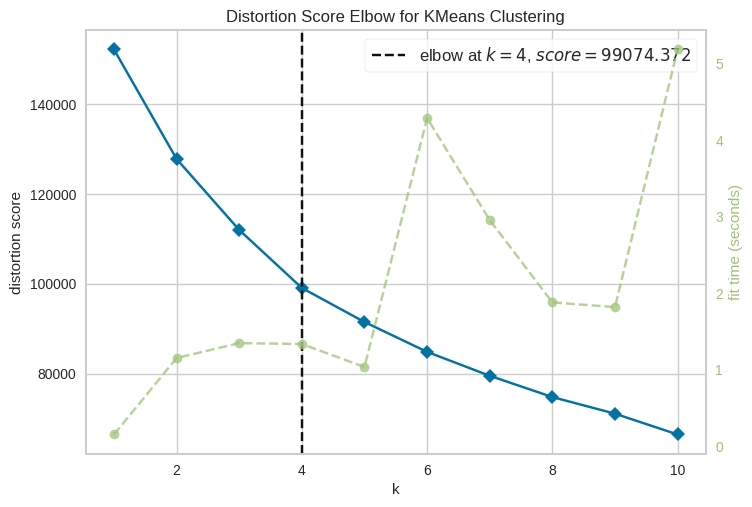

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
elbow_method = KElbowVisualizer(KMeans(), k=(1,11))
elbow_method.fit(df_scaled)
elbow_method.show()

* Theo đánh giá từ biểu đồ tại k = 4 cho sai số đủ tốt để thực hiện phân cụm dữ liệu

Tìm label cho mỗi dataset bằng thuật toán Kmean với k = 4

In [ ]:
model = KMeans(n_clusters= 4,
               init = 'random',
               n_init = 'auto',
               max_iter = 300,
               random_state = 108,
               algorithm = 'lloyd')
pipeline = apply_model(model,df_preprocessed.copy())
pipeline

Pipeline(steps=[('scaler', StandardScaler()),
                ('model',
                 KMeans(init='random', n_clusters=4, n_init='auto',
                        random_state=108))])

In [ ]:
# Xuat centroids
pipeline['model'].cluster_centers_

array([[-0.39502532,  0.21398116,  0.05322864, -0.12099666,  0.34406692,
        -0.4480589 ,  0.9521207 ,  0.13751514,  0.87748028, -0.49493836,
        -0.44355101,  0.28540007, -0.17897101, -0.24546514, -0.16865577,
         0.37858466,  0.03322295],
       [ 1.36687389,  0.36939381, -0.36107466, -0.26516976, -0.36069051,
         1.7610394 , -0.57839535, -0.27807649, -0.51167329,  1.64047077,
         1.69574359, -0.40175158,  0.73834979,  0.65050045,  0.71737591,
        -0.40203508, -0.09519851],
       [ 0.60027599,  0.44128326,  2.56218112,  2.34552267,  1.70283893,
        -0.17947935,  1.11514259,  1.70954161,  0.9363702 , -0.28531068,
        -0.20247997,  2.24757889,  1.10471076,  1.47401251,  0.37913828,
         0.4367556 ,  0.28446838],
       [-0.29974294, -0.39939841, -0.46104541, -0.30857559, -0.51216218,
        -0.2316539 , -0.79904456, -0.37658286, -0.72454732, -0.12798175,
        -0.2069609 , -0.56652838, -0.3564711 , -0.35025106, -0.20220548,
        -0.25460145

## Visualization dataset with orginal and predict cluster

In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components=len(df_preprocessed.columns))
pca.fit(df_preprocessed)

PCA(n_components=17)

In [ ]:
# Luong thong tin giu lai giai thich bao nhieu phan tram data goc
print(pca.explained_variance_ratio_*100)

[4.75291089e+01 1.77787721e+01 1.39775550e+01 1.13617030e+01
 4.81881708e+00 2.72660042e+00 1.80664389e+00 6.64158097e-04
 7.20026164e-05 5.87912636e-05 3.83955390e-06 4.19037373e-07
 1.48208983e-07 1.42855479e-07 9.41806299e-08 2.60471871e-08
 1.51703943e-08]


* Với việc plot trên dữ liệu 2D và 3D:
  * 2 component giữ 65.3%
  * 3 component giữ 79.27%

## 2 Dimensional PCA

In [ ]:
pca = PCA(n_components = 2)
model = apply_model(pca,df_preprocessed.copy())
df_pca_2 = pd.DataFrame(model.transform(df_preprocessed),
                      columns = ['pca_1', 'pca_2'])
df_pca_2

,pca_1,pca_2
0,-1.750478,-1.553188
1,-1.688976,2.845666
2,1.064026,-0.233977
3,-0.796363,-0.147251
4,-1.714381,-1.093060
...,...,...
8945,-0.255925,-2.252396
8946,-0.461465,-1.777750
8947,-0.893259,-2.158265
8948,-2.514214,-1.252042


Text(0.5, 1.0, 'Kmeans cluster')

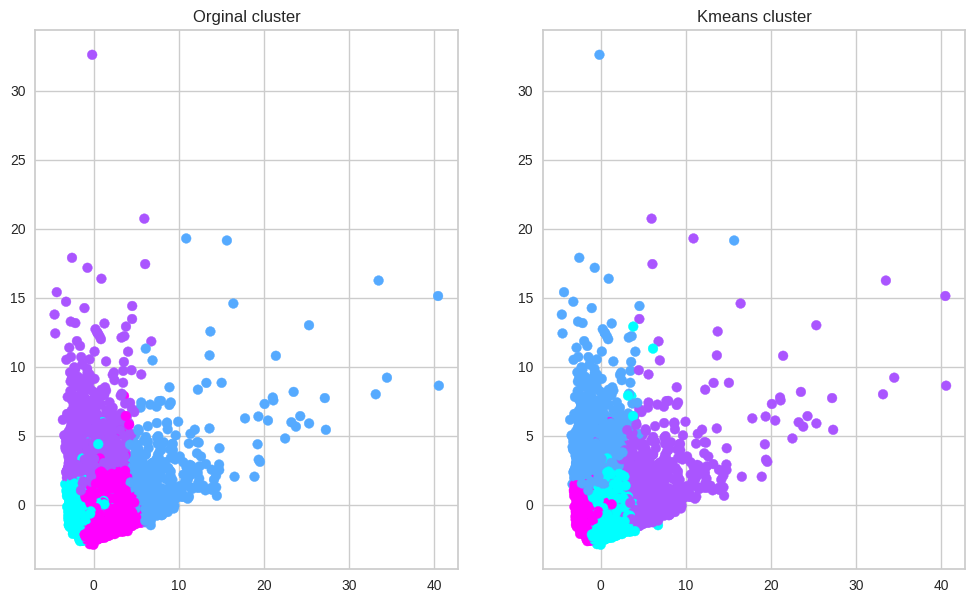

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(12,7))
ax[0].scatter(df_pca_2.pca_1, df_pca_2.pca_2,
              c=cluster_label, cmap='cool')
ax[0].set_title('Orginal cluster')

ax[1].scatter(df_pca_2.pca_1, df_pca_2.pca_2,
              c=labels, cmap='cool')
ax[1].set_title('Kmeans cluster')

## 3 Dimensional PCA


In [ ]:
pca = PCA(n_components = 3)
model = apply_model(pca,df_preprocessed.copy())
df_pca_3 = pd.DataFrame(model.transform(df_preprocessed),
                      columns = ['pca_1', 'pca_2', 'pca_3'])
df_pca_3

,pca_1,pca_2,pca_3
0,-1.750478,-1.553188,0.205591
1,-1.688976,2.845666,0.580491
2,1.064026,-0.233977,1.048276
3,-0.796363,-0.147251,1.537685
4,-1.714381,-1.093060,0.238707
...,...,...,...
8945,-0.255925,-2.252396,-1.266658
8946,-0.461465,-1.777750,-1.679941
8947,-0.893259,-2.158265,-0.806122
8948,-2.514214,-1.252042,0.603596


In [ ]:
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot

fig = px.scatter_3d(df_pca_3, x='pca_1', y='pca_2', z='pca_3',
              color=cluster_label, title = '3D Plot of Label from data')
fig.show()

In [ ]:
px.scatter_3d(df_pca_3, x='pca_1', y='pca_2', z='pca_3',
              color=labels, title = '3D Plot of predict label')
fig.show()

In [ ]:
df_copy = df.copy()
df_copy['Cluster_pred'] = labels
for k in range(0,4):
  print(f'Cluster {k}: ')
  print('* Ground Truth *')
  display(df_copy.iloc[np.where(df_copy['Cluster']==k)[0],1:-2].describe().transpose())
  print('* Predict Clusster *')
  display(df_copy.iloc[np.where(df_copy['Cluster_pred']==k)[0],1:-2].describe().transpose())
  print('\n')

Cluster 0: 
* Ground Truth *


,count,mean,std,min,25%,50%,75%,max
BALANCE,3976.0,1011.751528,1097.368627,0.000000,82.249034,763.684601,1505.001170,8115.039014
BALANCE_FREQUENCY,3976.0,0.789871,0.295184,0.000000,0.545455,1.000000,1.000000,1.000000
PURCHASES,3976.0,269.973466,467.629965,0.000000,0.000000,79.100000,339.767500,4900.000000
ONEOFF_PURCHASES,3976.0,209.853863,448.020861,0.000000,0.000000,0.000000,211.877500,4900.000000
INSTALLMENTS_PURCHASES,3976.0,60.386625,155.198248,0.000000,0.000000,0.000000,51.207500,3000.000000
CASH_ADVANCE,3976.0,595.759339,918.845971,0.000000,0.000000,116.886449,934.970675,6523.780195
PURCHASES_FREQUENCY,3976.0,0.170146,0.188211,0.000000,0.000000,0.083333,0.333333,1.000000
ONEOFF_PURCHASES_FREQUENCY,3976.0,0.086281,0.135703,0.000000,0.000000,0.000000,0.100000,1.000000
PURCHASES_INSTALLMENTS_FREQUENCY,3976.0,0.080578,0.148779,0.000000,0.000000,0.000000,0.083333,0.857143
CASH_ADVANCE_FREQUENCY,3976.0,0.114833,0.136996,0.000000,0.000000,0.083333,0.166667,0.857143


* Predict Clusster *


,count,mean,std,min,25%,50%,75%,max
BALANCE,3035.0,774.385209,1065.058380,0.000000,68.026575,263.636920,1137.133230,6991.964344
BALANCE_FREQUENCY,3035.0,0.926768,0.172155,0.000000,0.954546,1.000000,1.000000,1.000000
PURCHASES,3035.0,992.592511,747.071798,8.400000,405.555000,773.170000,1432.930000,4327.920000
ONEOFF_PURCHASES,3035.0,398.863914,590.784024,0.000000,0.000000,65.000000,644.735000,3943.930000
INSTALLMENTS_PURCHASES,3035.0,594.121769,560.456281,0.000000,222.075000,432.300000,799.920000,4249.920000
CASH_ADVANCE,3035.0,172.638061,508.294762,0.000000,0.000000,0.000000,0.000000,7894.578816
PURCHASES_FREQUENCY,3035.0,0.872483,0.160196,0.166667,0.750000,0.916667,1.000000,1.000000
ONEOFF_PURCHASES_FREQUENCY,3035.0,0.243481,0.327942,0.000000,0.000000,0.083333,0.416667,1.000000
PURCHASES_INSTALLMENTS_FREQUENCY,3035.0,0.713170,0.306117,0.000000,0.500000,0.833333,1.000000,1.000000
CASH_ADVANCE_FREQUENCY,3035.0,0.038263,0.094340,0.000000,0.000000,0.000000,0.000000,0.750000




Cluster 1: 
* Ground Truth *


,count,mean,std,min,25%,50%,75%,max
BALANCE,409.0,3551.153761,3344.579386,137.636267,881.358988,2492.726282,5193.415429,19043.13856
BALANCE_FREQUENCY,409.0,0.986879,0.059070,0.272727,1.000000,1.000000,1.000000,1.00000
PURCHASES,409.0,7681.620098,5978.185287,900.870000,4569.650000,5848.550000,8533.540000,49039.57000
ONEOFF_PURCHASES,409.0,5095.878826,5377.597586,0.000000,2265.110000,3705.130000,6206.990000,40761.25000
INSTALLMENTS_PURCHASES,409.0,2587.208264,2727.924691,0.000000,835.800000,1827.960000,3176.000000,22500.00000
CASH_ADVANCE,409.0,653.638891,1872.977038,0.000000,0.000000,0.000000,283.476295,19513.47483
PURCHASES_FREQUENCY,409.0,0.946418,0.134578,0.166667,1.000000,1.000000,1.000000,1.00000
ONEOFF_PURCHASES_FREQUENCY,409.0,0.739031,0.289475,0.000000,0.583333,0.833333,1.000000,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,409.0,0.788060,0.313123,0.000000,0.666667,1.000000,1.000000,1.00000
CASH_ADVANCE_FREQUENCY,409.0,0.071290,0.153532,0.000000,0.000000,0.000000,0.083333,1.00000


* Predict Clusster *


,count,mean,std,min,25%,50%,75%,max
BALANCE,1349.0,4282.853590,2686.845405,51.422178,2221.252825,3838.460036,5890.807655,16304.88925
BALANCE_FREQUENCY,1349.0,0.964259,0.099508,0.181818,1.000000,1.000000,1.000000,1.00000
PURCHASES,1349.0,411.491601,888.976376,0.000000,0.000000,57.000000,529.300000,22101.78000
ONEOFF_PURCHASES,1349.0,263.161764,780.969104,0.000000,0.000000,0.000000,245.010000,22101.78000
INSTALLMENTS_PURCHASES,1349.0,148.405204,357.887363,0.000000,0.000000,0.000000,105.250000,3887.00000
CASH_ADVANCE,1349.0,4225.035744,3405.194116,0.000000,2144.180453,3449.910317,5197.145458,47137.21176
PURCHASES_FREQUENCY,1349.0,0.258213,0.336418,0.000000,0.000000,0.083333,0.500000,1.00000
ONEOFF_PURCHASES_FREQUENCY,1349.0,0.119502,0.206830,0.000000,0.000000,0.000000,0.166667,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,1349.0,0.161085,0.289721,0.000000,0.000000,0.000000,0.166667,1.00000
CASH_ADVANCE_FREQUENCY,1349.0,0.461253,0.225230,0.000000,0.272727,0.416667,0.583333,1.50000




Cluster 2: 
* Ground Truth *


,count,mean,std,min,25%,50%,75%,max
BALANCE,1198.0,4602.462714,2754.575494,78.114579,2480.135387,4275.708869,6239.276755,16304.88925
BALANCE_FREQUENCY,1198.0,0.968415,0.091212,0.181818,1.000000,1.000000,1.000000,1.00000
PURCHASES,1198.0,501.896219,862.938799,0.000000,0.000000,85.730000,654.852500,7194.53000
ONEOFF_PURCHASES,1198.0,320.373681,666.283102,0.000000,0.000000,0.000000,330.352500,6678.26000
INSTALLMENTS_PURCHASES,1198.0,181.607404,416.133434,0.000000,0.000000,0.000000,144.625000,4059.93000
CASH_ADVANCE,1198.0,4520.724309,3622.443388,0.000000,2321.162031,3653.331329,5592.000447,47137.21176
PURCHASES_FREQUENCY,1198.0,0.287731,0.354104,0.000000,0.000000,0.083333,0.571429,1.00000
ONEOFF_PURCHASES_FREQUENCY,1198.0,0.138934,0.228871,0.000000,0.000000,0.000000,0.166667,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,1198.0,0.185516,0.311182,0.000000,0.000000,0.000000,0.333333,1.00000
CASH_ADVANCE_FREQUENCY,1198.0,0.484526,0.228421,0.000000,0.333333,0.500000,0.666667,1.50000


* Predict Clusster *


,count,mean,std,min,25%,50%,75%,max
BALANCE,804.0,2844.284620,2956.157948,12.659909,595.671944,1903.177275,4099.630483,19043.13856
BALANCE_FREQUENCY,804.0,0.980758,0.070989,0.272727,1.000000,1.000000,1.000000,1.00000
PURCHASES,804.0,5524.107786,4788.315534,1150.780000,3184.262500,4190.200000,5907.260000,49039.57000
ONEOFF_PURCHASES,804.0,3682.110995,4118.514351,0.000000,1645.612500,2744.270000,4067.230000,40761.25000
INSTALLMENTS_PURCHASES,804.0,1842.743060,2178.009848,0.000000,530.960000,1305.495000,2299.672500,22500.00000
CASH_ADVANCE,804.0,700.631129,2063.791223,0.000000,0.000000,0.000000,390.192812,29282.10915
PURCHASES_FREQUENCY,804.0,0.937911,0.138364,0.166667,0.916667,1.000000,1.000000,1.00000
ONEOFF_PURCHASES_FREQUENCY,804.0,0.712447,0.285286,0.000000,0.500000,0.750000,1.000000,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,804.0,0.736575,0.336695,0.000000,0.573863,0.916667,1.000000,1.00000
CASH_ADVANCE_FREQUENCY,804.0,0.079659,0.159845,0.000000,0.000000,0.000000,0.083333,1.00000




Cluster 3: 
* Ground Truth *


,count,mean,std,min,25%,50%,75%,max
BALANCE,3367.0,894.907458,1212.134419,0.000000,80.529535,337.269567,1256.639648,9502.256762
BALANCE_FREQUENCY,3367.0,0.934734,0.161833,0.000000,1.000000,1.000000,1.000000,1.000000
PURCHASES,3367.0,1236.178934,1041.149669,8.400000,439.960000,892.300000,1772.165000,6520.000000
ONEOFF_PURCHASES,3367.0,593.974874,872.592208,0.000000,0.000000,168.540000,903.000000,6520.000000
INSTALLMENTS_PURCHASES,3367.0,642.478274,623.932335,0.000000,223.255000,450.670000,874.375000,4538.840000
CASH_ADVANCE,3367.0,210.570626,602.337305,0.000000,0.000000,0.000000,0.000000,7894.578816
PURCHASES_FREQUENCY,3367.0,0.885165,0.150874,0.250000,0.800000,1.000000,1.000000,1.000000
ONEOFF_PURCHASES_FREQUENCY,3367.0,0.297070,0.353245,0.000000,0.000000,0.111111,0.583333,1.000000
PURCHASES_INSTALLMENTS_FREQUENCY,3367.0,0.711842,0.313701,0.000000,0.545455,0.833333,1.000000,1.000000
CASH_ADVANCE_FREQUENCY,3367.0,0.042573,0.099497,0.000000,0.000000,0.000000,0.000000,0.750000


* Predict Clusster *


,count,mean,std,min,25%,50%,75%,max
BALANCE,3762.0,953.592842,1031.256054,0.000000,72.734295,702.356914,1437.808090,6619.148640
BALANCE_FREQUENCY,3762.0,0.784029,0.298883,0.000000,0.545455,1.000000,1.000000,1.000000
PURCHASES,3762.0,257.756555,427.855026,0.000000,0.000000,79.705000,331.737500,3950.000000
ONEOFF_PURCHASES,3762.0,206.363644,418.604749,0.000000,0.000000,0.000000,219.092500,3950.000000
INSTALLMENTS_PURCHASES,3762.0,51.603352,120.958001,0.000000,0.000000,0.000000,43.375000,1500.000000
CASH_ADVANCE,3762.0,524.736655,814.958732,0.000000,0.000000,96.901243,842.306161,6523.780195
PURCHASES_FREQUENCY,3762.0,0.169655,0.187369,0.000000,0.000000,0.083333,0.333333,1.000000
ONEOFF_PURCHASES_FREQUENCY,3762.0,0.090116,0.142343,0.000000,0.000000,0.000000,0.121528,1.000000
PURCHASES_INSTALLMENTS_FREQUENCY,3762.0,0.076484,0.143062,0.000000,0.000000,0.000000,0.083333,0.750000
CASH_ADVANCE_FREQUENCY,3762.0,0.108223,0.131810,0.000000,0.000000,0.083333,0.166667,0.900000


* Với cluster 0,3: số datapoint bằng kmean ít hơn so với ground truth
* Ngược lại với cluster 1,2: số data point được dự đoán nhiều hơn ground truth
* Đặc biệt cluster 1 nhầm lẫn nhiều gấp 3.3 lần với ground truth

In [ ]:
for k in range(0,4):
  gt = df_copy.iloc[np.where(df_copy['Cluster']==k)[0],1:-2].mean()
  pred = df_copy.iloc[np.where(df_copy['Cluster_pred']==k)[0],1:-2].mean()
  print(f'Cluster {k}: ')
  print('Error distance mean ground truth vs prediction: ', np.linalg.norm(gt-pred))
  print('\n')

Cluster 0: 
Error distance mean ground truth vs prediction:  1193.0776096723305


Cluster 1: 
Error distance mean ground truth vs prediction:  10894.22527216295


Cluster 2: 
Error distance mean ground truth vs prediction:  7879.387384281428


Cluster 3: 
Error distance mean ground truth vs prediction:  1650.8444388161




* Trung bình của 2 cluster 1,2 có sự khác biệt khá lớn giữa ground truth và prediction nên độ chính xác so với thực tế kém hơn hẳn

## Yếu tố quyết định đến việc phân chia cluster

Để xác định yếu tố ảnh hưởng đến clustering của kmean

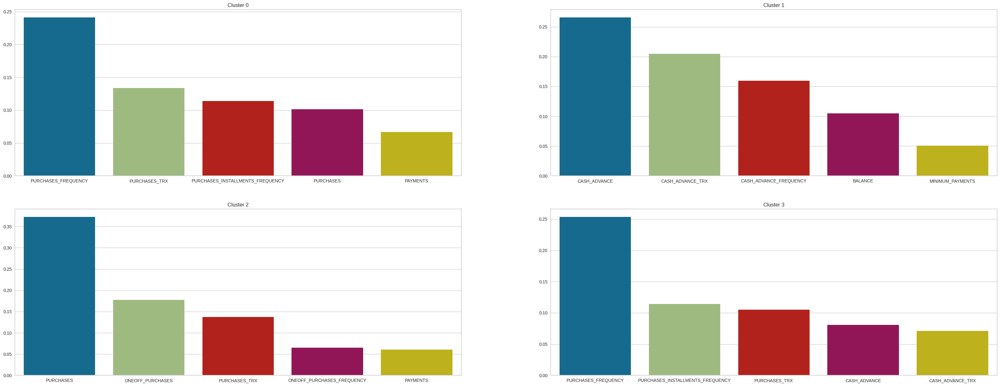

<Figure size 3000x1500 with 0 Axes>

<Figure size 3000x1500 with 0 Axes>

<Figure size 3000x1500 with 0 Axes>

<Figure size 3000x1500 with 0 Axes>

In [ ]:
from sklearn.ensemble import RandomForestClassifier

fig, ax =  plt.subplots(2,2,figsize=(40,15))
ax = ax.ravel()
for k in range(0,4):
  clf = RandomForestClassifier(random_state=42)
  lbs = np.where(labels == k, 1, 0)
  pipeline_rf = apply_model(clf, df_preprocessed.copy(), lbs)

  # Index sort most importance features
  sorted_feature_weight_idx = np.argsort(pipeline_rf['model'].feature_importances_)[::-1]

  # Get name and value
  ip_feaures = np.take_along_axis(
    np.array(df_preprocessed.columns.tolist()),
    sorted_feature_weight_idx, axis = 0
  )

  ip_values = np.take_along_axis(
    np.array(pipeline_rf['model'].feature_importances_),
    sorted_feature_weight_idx, axis = 0
  )

  # Bar plot
  plt.figure(figsize=(30,15))
  sns.barplot(x = ip_feaures[:5], y =ip_values[:5], ax= ax[k])
  ax[k].set_title(f'Cluster {k}')

* Ở đây số lần mua ảnh hưởng đến việc phân loại nhóm người dùng

In [ ]:
for f in ['PURCHASES_FREQUENCY', 'CASH_ADVANCE_TRX',\
          'PURCHASES']:
  print(f'Feature {f}')
  for k in range(0,4):
    print(f'Cluster {k}: ')
    cluster_k1 = df_copy.loc[np.where(df_copy['Cluster_pred']==k)[0],f]
    print(f'Range: [{np.min(cluster_k1)},{np.max(cluster_k1)}]')
  print('\n')

Feature PURCHASES_FREQUENCY
Cluster 0: 
Range: [0.166667,1.0]
Cluster 1: 
Range: [0.0,1.0]
Cluster 2: 
Range: [0.166667,1.0]
Cluster 3: 
Range: [0.0,1.0]


Feature CASH_ADVANCE_TRX
Cluster 0: 
Range: [0,23]
Cluster 1: 
Range: [0,123]
Cluster 2: 
Range: [0,62]
Cluster 3: 
Range: [0,23]


Feature PURCHASES
Cluster 0: 
Range: [8.4,4327.92]
Cluster 1: 
Range: [0.0,22101.78]
Cluster 2: 
Range: [1150.78,49039.57]
Cluster 3: 
Range: [0.0,3950.0]




* Dựa trên biểu đồ 2D, 3D ta thấy dự liệu với các cụm gần nhau nên việc phân chia kém hiệu quả trong đó:
  * Với cluster 0, 3: PURCHASES_FREQUENCY
  * Với cluster 1: CASH_ADVANCE
  * Với cluster 2: PURCHASES

## Test score by silhouette

For n_clusters = 4 The average silhouette_score is : 0.40107037176906524


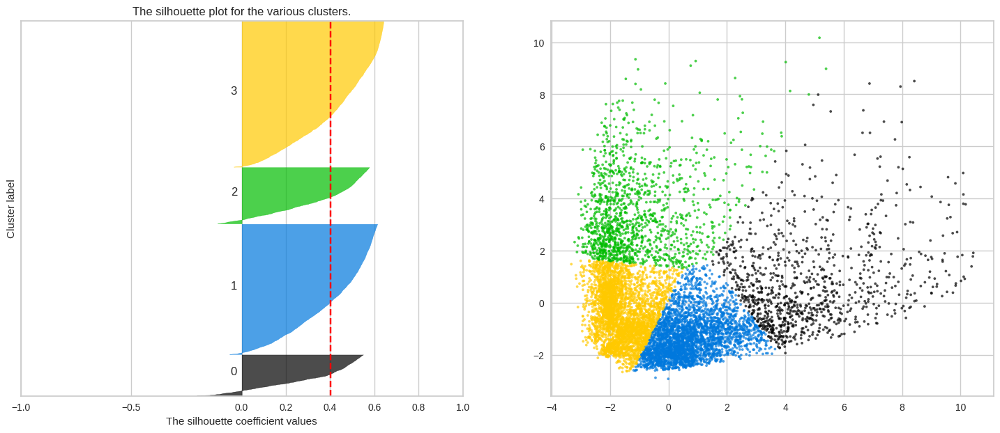

In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.cm as cm

n_clusters = 4
# Tạo axis cho 2 hình
fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)

# Plot đầu tiên cho silhouette
# Kết quả của silhouette nằm trong khoảng từ -1 đến 1
ax1.set_xlim([-1, 1])
ax1.set_ylim([0, len(df_preprocessed) + (n_clusters + 1) * 10])

# Silhouette score lấy trung bình giá trị của tất cả sample
# Giảm chiều dữ liệu xuống còn 2 chiều để trực quan hóa
data_temp = df_preprocessed.copy()
pca = PCA(n_components = 2)
model = apply_model(pca,data_temp)
X = pd.DataFrame(model.transform(data_temp),
                      columns = ['pca_1', 'pca_2'])


cluster = KMeans(n_clusters= 4,
               init = 'random',
               n_init = 'auto',
               max_iter = 300,
               random_state = 100,
               algorithm = 'lloyd')
clt = apply_model(cluster, X.copy())
labels = clt['model'].labels_


silhouette_avg = silhouette_score(X, labels)
print(
    "For n_clusters =",
    n_clusters,
    "The average silhouette_score is :",
    silhouette_avg,
)
# Compute the silhouette scores for each sample
sample_silhouette_values = silhouette_samples(X, labels)
y_lower = 10
for i in range(n_clusters):
    # Aggregate the silhouette scores for samples belonging to
    # cluster i, and sort them
    ith_cluster_silhouette_values = sample_silhouette_values[labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(
        np.arange(y_lower, y_upper),
        0,
        ith_cluster_silhouette_values,
        facecolor=color,
        edgecolor=color,
        alpha=0.7,
    )
    # Label the silhouette plots with their cluster numbers at the middle
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    # Compute the new y_lower for next plot
    y_lower = y_upper + 10  # 10 for the 0 sample
ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("The silhouette coefficient values")
ax1.set_ylabel("Cluster label")
# The vertical line for average silhouette score of all the values
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
ax1.set_yticks([])  # Clear the yaxis labels / ticks
ax1.set_xticks([-1,-0.5, 0, 0.2, 0.4, 0.6, 0.8, 1])


# 2nd Plot showing the actual clusters formed
colors = cm.nipy_spectral(labels.astype(float) / n_clusters)
ax2.scatter(
    X.iloc[:, 0], X.iloc[:, 1],
    marker=".", s=30, lw=0,
    alpha=0.7, c=colors, edgecolor="k")


* Silhouette score lấy trung bình giá trị của nhiều chiều

For n_clusters = 4 The average silhouette_score is : 0.04356173035445353


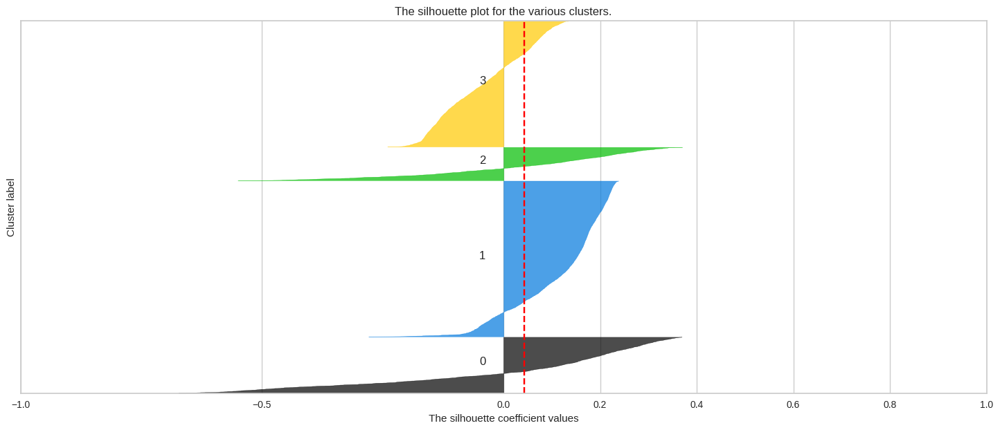

In [ ]:
fig, ax1 = plt.subplots(1, 1)
fig.set_size_inches(18, 7)

# Plot đầu tiên cho silhouette
# Kết quả của silhouette nằm trong khoảng từ -1 đến 1
ax1.set_xlim([-1, 1])
ax1.set_ylim([0, len(df_preprocessed) + (n_clusters + 1) * 10])

# Silhouette score lấy trung bình giá trị của tất cả sample
# Giảm chiều dữ liệu xuống còn 2 chiều để trực quan hóa

X = df_preprocessed.copy()
cluster = KMeans(n_clusters= 4,
               init = 'random',
               n_init = 'auto',
               max_iter = 300,
               random_state = 42,
               algorithm = 'lloyd')
clt = apply_model(cluster, X)
labels = clt['model'].labels_

silhouette_avg = silhouette_score(X, labels)
print(
    "For n_clusters =",
    n_clusters,
    "The average silhouette_score is :",
    silhouette_avg,
)
# Compute the silhouette scores for each sample
sample_silhouette_values = silhouette_samples(X, labels)
y_lower = 10
for i in range(n_clusters):
    # Aggregate the silhouette scores for samples belonging to
    # cluster i, and sort them
    ith_cluster_silhouette_values = sample_silhouette_values[labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(
        np.arange(y_lower, y_upper),
        0,
        ith_cluster_silhouette_values,
        facecolor=color,
        edgecolor=color,
        alpha=0.7,
    )
    # Label the silhouette plots with their cluster numbers at the middle
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    # Compute the new y_lower for next plot
    y_lower = y_upper + 10  # 10 for the 0 sample
ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("The silhouette coefficient values")
ax1.set_ylabel("Cluster label")
# The vertical line for average silhouette score of all the values
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
ax1.set_yticks([])  # Clear the yaxis labels / ticks
ax1.set_xticks([-1,-0.5, 0, 0.2, 0.4, 0.6, 0.8, 1])


# Discussion & Conclusion

* Đánh giá chủ quan:
  * Dữ liệu trên chưa thực sự tốt khi khá nhiều cụm chèn vào nhau
  * Purchases frequency, ONEOFF_PURCHASES_FREQUENCY, CASH_ADVANCE_TRX, PURCHASES_INSTALLMENTS_FREQUENCY  lần lượt là  nhân tố quyết định phân loại cụm 0,1,2,3
  * Với kết quả từ silhoutette trung bình khi phân 4 cụm 2 dac trung là 40.1%
  * Với kết quả từ silhoutette trung bình khi phân 4 cụm toan bo dac trung là 4.3%
  * Du lieu chieu > 2 cang nho thuat toan voi du lieu tren cho ket qua phan cum tot hon
  * So lieu cho thay thuat toan phan nham nhom cluster 1 va 3 nhieu nhat va hien thi ro tren silhouette plot
    * Li giai (chu quan)
      * Voi cluster 1 phan cum nho vao dac trung CASH_ADVANCE voi khoang co the trung gia tri 3 nhom con lai
      * Voi cluster 3 phan cum nho vao dac trung PURCHASE_FREQUENCE tuong tu li luan nhu cluster 1